# M2177.003100 Deep Learning <br> Assignment #4 Implementing Conditional Generative Adversarial Nets - part3 Labeld Face Data

Copyright (C) Data Science Laboratory, Seoul National University. This material is for educational uses only. Some contents are based on the material provided by other paper/book authors and may be copyrighted by them. Written by Jaeyoon Yoo, November 2017

In this notebook, you will learn how to implement conditional Genverative Adversarial Nets (cGANs) <br>
The goal here is to build GANs that draw a face given its label. You can draw a black male/black female/white male/white female as you gives an input at the end of training. <br> 

**Note**: certain details are missing or ambiguous on purpose, in order to test your knowledge on the related materials. However, if you really feel that something essential is missing and cannot proceed to the next step, then contact the teaching staff with clear description of your problem.

### Submitting your work:
<font color=red>**DO NOT clear the final outputs**</font> so that TAs can grade both your code and results.  
Once you have done **all parts**, run the *CollectSubmission.sh* script with your **Team number** as input argument. <br>
This will produce a zipped file called *[Your team number].zip*. Please submit this file on ETL. &nbsp;&nbsp; (Usage: ./*CollectSubmission.sh* &nbsp; Team_#)

### Some helpful tutorials and references for assignment #3:
- [1] TensorFlow official tutorials. [[link]](https://www.tensorflow.org/get_started/get_started)
- [2] Stanford CS231n lectures. [[link]](http://cs231n.stanford.edu/)
- [3] Goodfellow, Ian, et al. "Generative adversarial nets." Advances in neural information processing systems. 2014.
- [4] Mirza, Mehdi, and Simon Osindero. "Conditional generative adversarial nets." arXiv preprint arXiv:1411.1784 (2014).
- [5] Radford, Alec, Luke Metz, and Soumith Chintala. "Unsupervised representation learning with deep convolutional generative adversarial networks." arXiv preprint arXiv:1511.06434 (2015).

## 0. Download and load Face datasets
Unzip the face_dataset.tar.gz in data directory as follows.<br>
**cd ./data**<br>
**tar -xf face_dataset.tar.gz**<br>

Following is how to load the data. Modify  *data_dir* to be the directory the data is in. Or you will get an error.<br>

In [1]:
from utils import load_face
data_dir = './data/face_dataset'
im, label = load_face(data_dir)

There are 13143 images and corresponding lables. Labels have three values. Following is the detail:

Label1 - Male/Female : positive value means male<br>
Label2 - White/Not white : positive value means White<br>
Lable3 - Black/Not black : positive value menas black<br>
The large value represents the more property it has.

Note that the labels are not normalized and check the data by runing and modifying following code

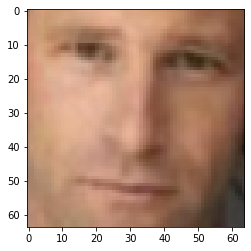

[ 1.56834639  1.73720325 -0.92972867]


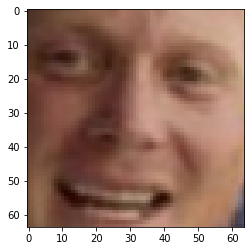

[ 0.16985062  0.42270934 -1.28218444]


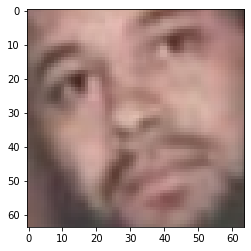

[ 0.99774898 -0.15737693 -0.75644725]


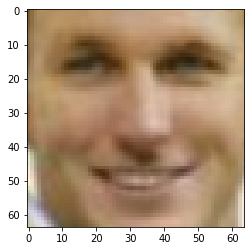

[ 1.12271853  1.91614437 -2.51421429]


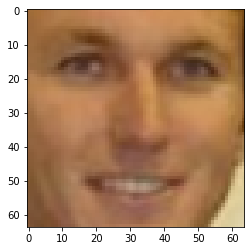

[ 1.07821424  1.67621104 -2.27805594]


In [2]:
import pylab as plt
for i in range(5):
    plt.imshow(im[i])
    plt.show()
    print(label[i])

## <a name="1"></a> 1. Build a network

In this section, you will implement neural networks for (1) generative model (2) discriminative model. You can reuse your code in part1 and improve it. Just write the code in whatever way you find most clear.

In [3]:
from utils import load_face
from utils import getNext_batch
from utils import save_images
from utils import vis_square
from utils import sample_label
from utils import sample_label_face
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import cv2

from ops import conv2d
from ops import lrelu
from ops import de_conv
from ops import fully_connect
from ops import conv_cond_concat
from ops import batch_normal

import tensorflow as tf
import numpy as np

learning_rate = 0.0002
batch_size = 128
EPOCH = 300
display_step = 50
sample_size = 100
y_dim = 3
channel = 3


It is time for a generative model. You can change anything including the argument If you need. Feel free to change it and improve it.

In [4]:
def gern_net(batch_size, z , y ,sample_size, y_dim, output_size,reuse=False):
 #### TODO ####
    with tf.variable_scope('gen', reuse=reuse):
        initializer = tf.contrib.layers.variance_scaling_initializer()
        gamma_initializer = tf.random_normal_initializer(1., 0.02)
        y_extend = tf.reshape(y, shape=[-1,1,1,y_dim])
        inputs = tf.concat(values=[z,y], axis=1)
        layer1 = tf.layers.dense(inputs,units=8192,kernel_initializer=initializer)
        layer1 = tf.reshape(layer1, [batch_size,4,4,512])
        
        inputs2 = conv_cond_concat(layer1,y_extend)
        layer2 = tf.layers.batch_normalization(inputs2, gamma_initializer=gamma_initializer)
        layer2 = tf.layers.conv2d_transpose(layer2,filters=512,kernel_size=5,strides=2,padding='SAME',
                                            activation=tf.nn.relu,kernel_initializer=initializer)
        
        inputs3 = conv_cond_concat(layer2,y_extend)
        layer3 = tf.layers.batch_normalization(inputs3, gamma_initializer=gamma_initializer)
        layer3 = tf.layers.conv2d_transpose(layer3,filters=128,kernel_size=5,strides=2,padding='SAME',
                                            activation=tf.nn.relu,kernel_initializer=initializer)
        
        inputs4 = conv_cond_concat(layer3,y_extend)
        layer4 = tf.layers.batch_normalization(inputs4, gamma_initializer=gamma_initializer)
        layer4 = tf.layers.conv2d_transpose(layer4,filters=64,kernel_size=5,strides=2,padding='SAME',
                                            activation=tf.nn.relu,kernel_initializer=initializer)        
        
        inputs5 = conv_cond_concat(layer4,y_extend)
        output = tf.layers.batch_normalization(inputs5, gamma_initializer=gamma_initializer)
        output = tf.layers.conv2d_transpose(output,filters=3,kernel_size=5,strides=2,padding='SAME',
                                            kernel_initializer=tf.contrib.layers.xavier_initializer())
        #print(output)

    return tf.nn.sigmoid(output)    


Now, it's time for a discriminative model. Again, you can change anything if you need

In [5]:
def dis_net(data_array , y, batch_size, reuse=False):
 #### TODO ####
    with tf.variable_scope('dis',reuse=reuse):
        initializer=tf.contrib.layers.variance_scaling_initializer()
        gamma_initializer = tf.random_normal_initializer(1., 0.02)
        
        y_extend = tf.reshape(y, shape=[-1,1,1,y.shape[1]])
        
        inputs = conv_cond_concat(data_array,y_extend)
        layer1 = tf.layers.conv2d(inputs,filters=64,kernel_size=5,strides=2,padding='SAME',
                                  activation=tf.nn.leaky_relu,kernel_initializer=initializer)
        
        inputs2 = conv_cond_concat(layer1,y_extend)
        layer2 = tf.layers.batch_normalization(inputs2,gamma_initializer=gamma_initializer)
        layer2 = tf.layers.conv2d(layer2,filters=128,kernel_size=5,strides=2,padding='SAME',
                                  activation=tf.nn.leaky_relu,kernel_initializer=initializer)
        
        inputs3 = conv_cond_concat(layer2,y_extend)
        layer3 = tf.layers.batch_normalization(inputs3,gamma_initializer=gamma_initializer)
        layer3 = tf.layers.conv2d(layer3,filters=256,kernel_size=5,strides=2,padding='SAME',
                                  activation=tf.nn.leaky_relu,kernel_initializer=initializer)
        
        inputs4 = conv_cond_concat(layer3,y_extend)
        layer4 = tf.layers.batch_normalization(inputs3,gamma_initializer=gamma_initializer)
        layer4 = tf.layers.conv2d(layer4,filters=512,kernel_size=5,strides=2,padding='SAME',
                                  activation=tf.nn.leaky_relu,kernel_initializer=initializer)
        
        inputs5 = conv_cond_concat(layer4,y_extend)
        inputs5 = tf.reshape(inputs5,shape=[batch_size,-1])
        output = tf.layers.batch_normalization(inputs5,gamma_initializer=gamma_initializer)
        output = tf.layers.dense(output,units=3,kernel_initializer=tf.contrib.layers.xavier_initializer())
        
    return tf.nn.sigmoid(output) , output



## <a name="2"></a> 2. Build a main part and train it

In this section, you will implement the main part. Then run the code and check the model draws the face properly.

When you are done, run the following to check your implementations.

Following code will make 'samples_for_test' directory that resulting image will be saved in. You can change the directory as you want.

In [6]:
from utils import load_mnist
from utils import save_images
from utils import vis_square
from utils import sample_label
from utils import getNext_batch
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import os

learning_rate = 0.0002
batch_size = 256
EPOCH = 200
loss_step= 50
display_step = 50
sample_size = 100
y_dim = 3
channel = 3
output_size = 64
sample_dir = 'samples_for_test/face'

if os.path.exists(sample_dir) == False:
    os.makedirs(sample_dir)

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

Feel free to fill in the main part. You can copy the part1 code or write your own code.

Your goal is to **generate 4 row and 8 column images(32 total)**.

**Each row should correspond to each label**.

First row : black male<br>
Second row: black female<br>
Third row : white male<br>
Fourth row: white female<br>

You can use "save_images" method in *utils.py* to align generated image by 4*8. See part1 code to get how to use it.

You must show **at least three generated images**. (At the beginning of ,in the midway of, at the end of training.)


EPOCH 0 step 50: D: loss = 1.4732316 G: loss=0.8046598 Time=20


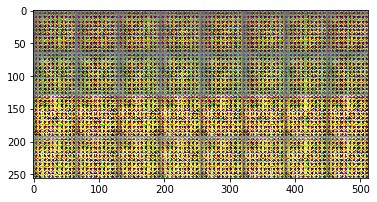

EPOCH 1 step 100: D: loss = 1.5160298 G: loss=0.6761456 Time=14


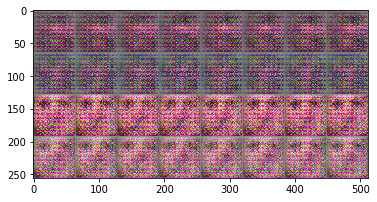

EPOCH 2 step 150: D: loss = 1.3533167 G: loss=0.7231279 Time=13


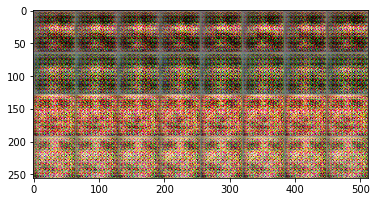

EPOCH 3 step 200: D: loss = 1.3782033 G: loss=0.7065879 Time=13


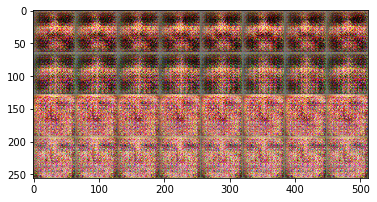

EPOCH 4 step 250: D: loss = 1.4059408 G: loss=0.6601723 Time=13


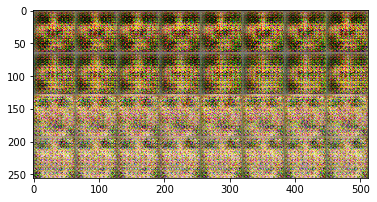

EPOCH 5 step 300: D: loss = 1.3815708 G: loss=0.7868073 Time=13


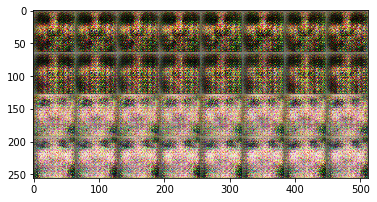

EPOCH 6 step 350: D: loss = 1.3338892 G: loss=0.7311832 Time=12


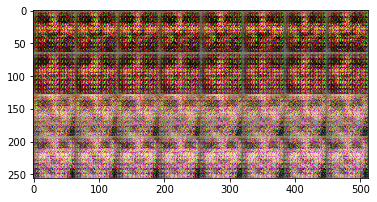

EPOCH 7 step 400: D: loss = 1.4942919 G: loss=0.9766241 Time=12


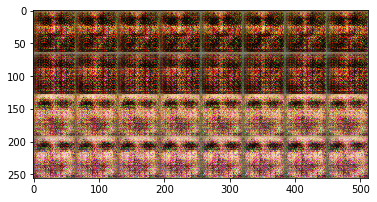

EPOCH 8 step 450: D: loss = 1.2806598 G: loss=0.5965009 Time=12


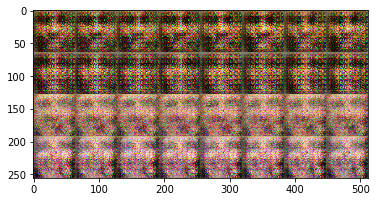

EPOCH 9 step 500: D: loss = 1.3657670 G: loss=0.6834953 Time=12


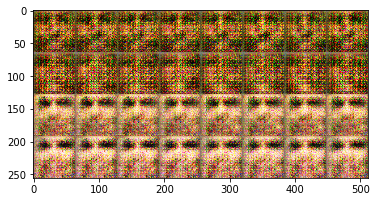

EPOCH 10 step 550: D: loss = 1.3316286 G: loss=0.6755750 Time=11


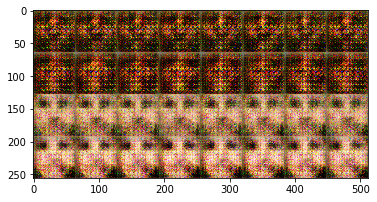

EPOCH 11 step 600: D: loss = 1.3235496 G: loss=0.8494249 Time=11


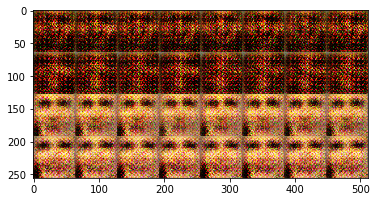

EPOCH 12 step 650: D: loss = 1.2318592 G: loss=0.7853625 Time=11


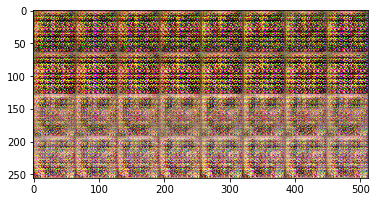

EPOCH 13 step 700: D: loss = 1.3645593 G: loss=1.0049505 Time=11


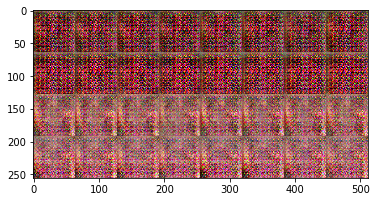

EPOCH 14 step 750: D: loss = 1.7988591 G: loss=1.9459209 Time=10


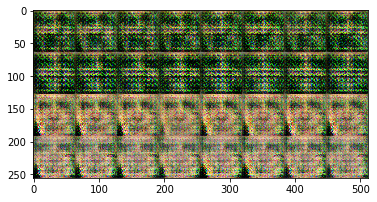

EPOCH 15 step 800: D: loss = 1.6932044 G: loss=0.6391101 Time=10


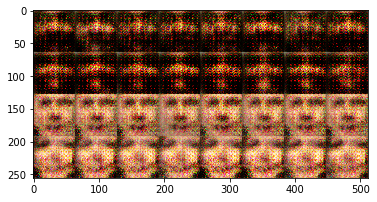

EPOCH 16 step 850: D: loss = 1.5667783 G: loss=1.2698643 Time=10


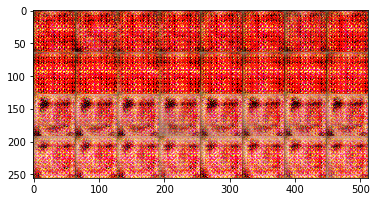

EPOCH 17 step 900: D: loss = 1.3830265 G: loss=0.6661859 Time=9


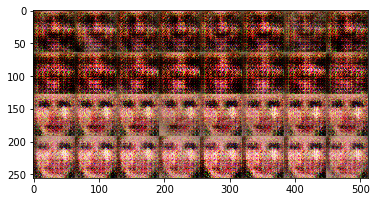

EPOCH 18 step 950: D: loss = 1.3054993 G: loss=0.7171860 Time=9


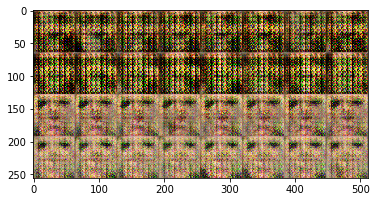

EPOCH 19 step 1000: D: loss = 1.2482464 G: loss=0.7701094 Time=9


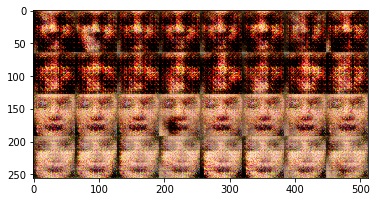

EPOCH 20 step 1050: D: loss = 1.3482953 G: loss=0.7106209 Time=9


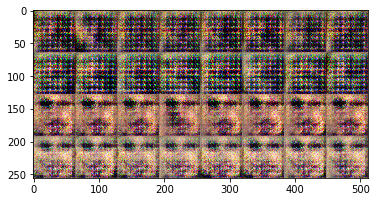

EPOCH 21 step 1100: D: loss = 1.4906236 G: loss=0.7244266 Time=8


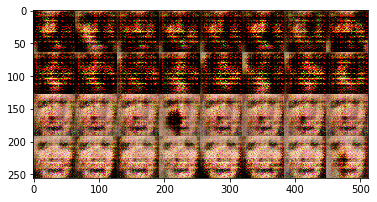

EPOCH 22 step 1150: D: loss = 1.2035782 G: loss=0.9429086 Time=8


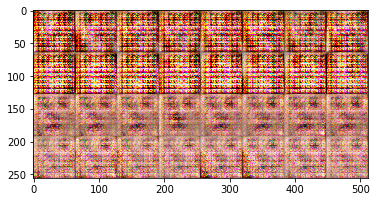

EPOCH 23 step 1200: D: loss = 1.3744732 G: loss=0.5509607 Time=8


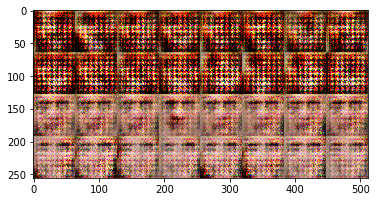

EPOCH 24 step 1250: D: loss = 1.1505725 G: loss=0.8617759 Time=7


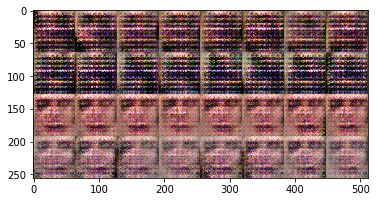

EPOCH 25 step 1300: D: loss = 1.2928491 G: loss=0.7120507 Time=7


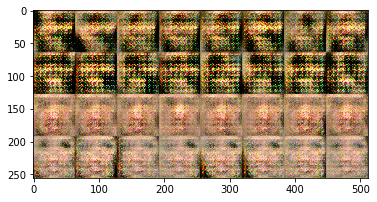

EPOCH 26 step 1350: D: loss = 1.6509415 G: loss=0.3377076 Time=7


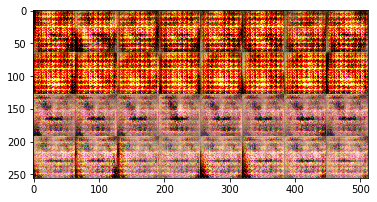

EPOCH 27 step 1400: D: loss = 1.2816370 G: loss=0.8249061 Time=6


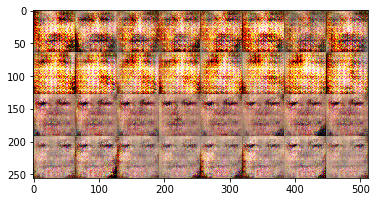

EPOCH 28 step 1450: D: loss = 1.1018496 G: loss=0.8442612 Time=6


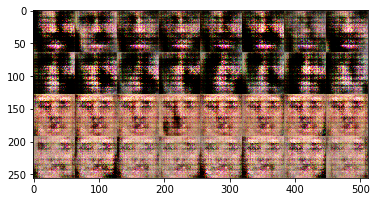

EPOCH 29 step 1500: D: loss = 1.1629088 G: loss=0.8067535 Time=6


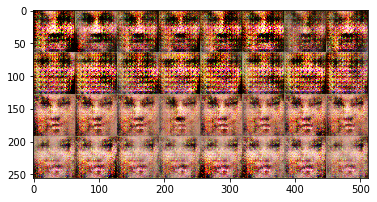

EPOCH 30 step 1550: D: loss = 1.3601670 G: loss=0.4672847 Time=6


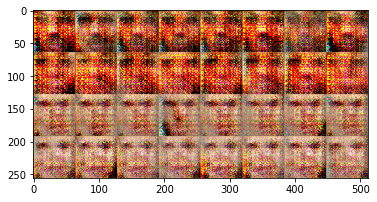

EPOCH 31 step 1600: D: loss = 1.3083948 G: loss=1.4413780 Time=5


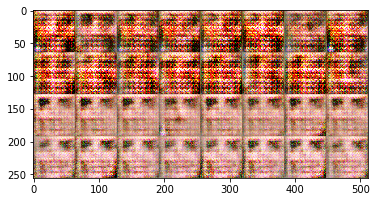

EPOCH 32 step 1650: D: loss = 1.7475370 G: loss=2.1327333 Time=5


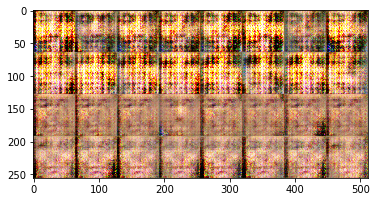

EPOCH 33 step 1700: D: loss = 1.2293229 G: loss=0.8445673 Time=5


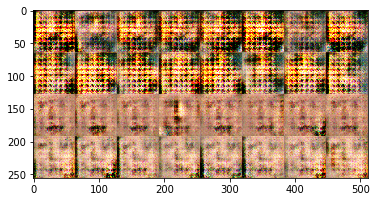

EPOCH 34 step 1750: D: loss = 1.1814802 G: loss=0.6326733 Time=4


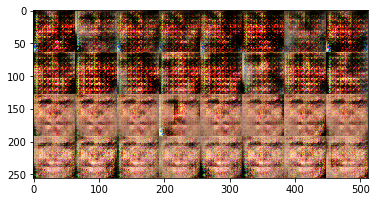

EPOCH 35 step 1800: D: loss = 1.1378262 G: loss=0.8143344 Time=4


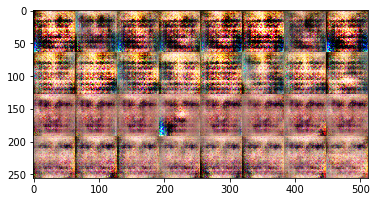

EPOCH 36 step 1850: D: loss = 1.2505863 G: loss=0.9346830 Time=4


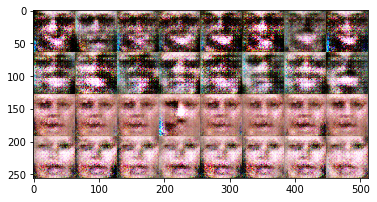

EPOCH 37 step 1900: D: loss = 1.3291590 G: loss=0.5829005 Time=3


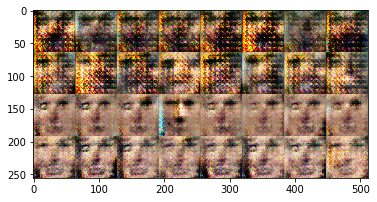

EPOCH 38 step 1950: D: loss = 1.4096041 G: loss=0.7335585 Time=3


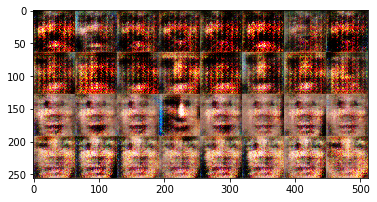

EPOCH 39 step 2000: D: loss = 1.1922002 G: loss=1.2199702 Time=3


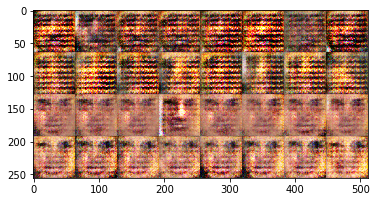

EPOCH 40 step 2050: D: loss = 1.1425378 G: loss=1.0316662 Time=3


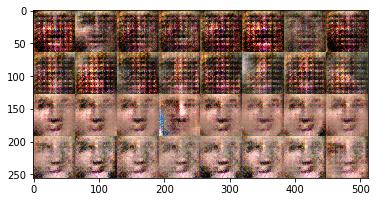

EPOCH 41 step 2100: D: loss = 1.2733600 G: loss=0.6619702 Time=2


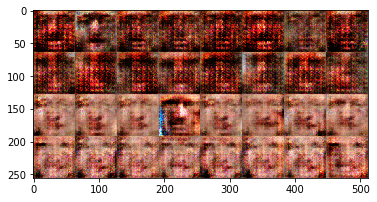

EPOCH 42 step 2150: D: loss = 1.0633337 G: loss=0.8388839 Time=2


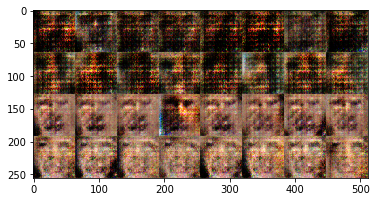

EPOCH 43 step 2200: D: loss = 1.2688856 G: loss=0.8593562 Time=2


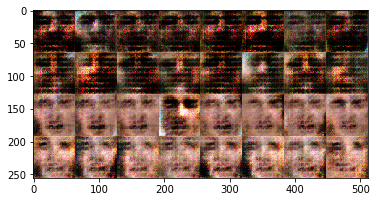

EPOCH 44 step 2250: D: loss = 1.1853769 G: loss=0.7562926 Time=1


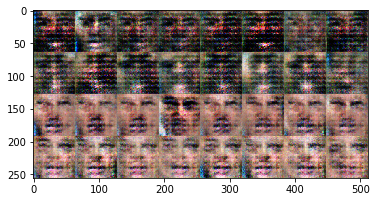

EPOCH 45 step 2300: D: loss = 1.3313240 G: loss=0.7997186 Time=1


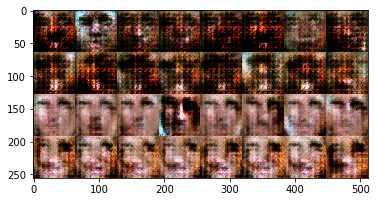

EPOCH 46 step 2350: D: loss = 1.1381173 G: loss=0.8702156 Time=1


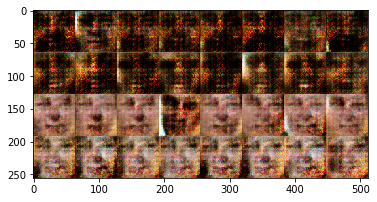

EPOCH 47 step 2400: D: loss = 1.1553310 G: loss=0.9421734 Time=1


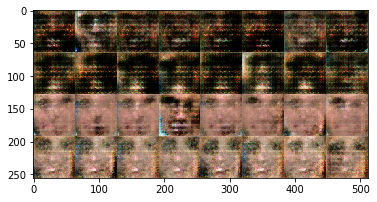

EPOCH 48 step 2450: D: loss = 1.3425940 G: loss=0.7474576 Time=0


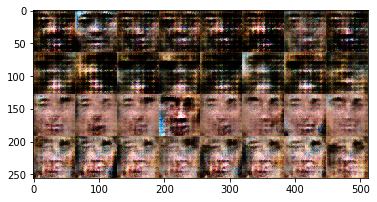

EPOCH 49 step 2500: D: loss = 1.2986089 G: loss=0.6145480 Time=0
EPOCH 49 step 2550: D: loss = 1.3759542 G: loss=0.7195857 Time=15


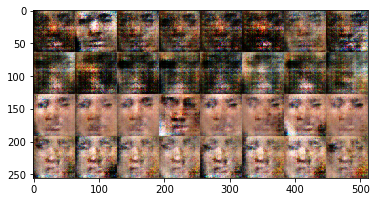

EPOCH 50 step 2600: D: loss = 1.2869008 G: loss=0.8114423 Time=15


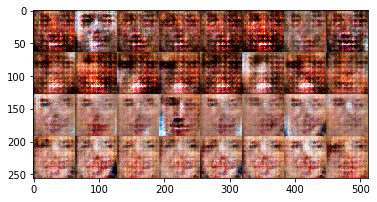

EPOCH 51 step 2650: D: loss = 1.2425102 G: loss=0.7326705 Time=14


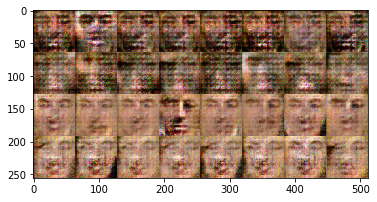

EPOCH 52 step 2700: D: loss = 1.2358558 G: loss=0.8001090 Time=14


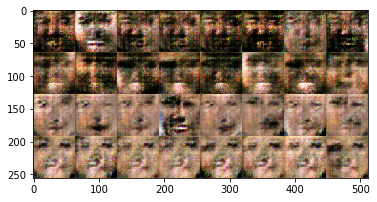

EPOCH 53 step 2750: D: loss = 1.3583379 G: loss=0.7152527 Time=14


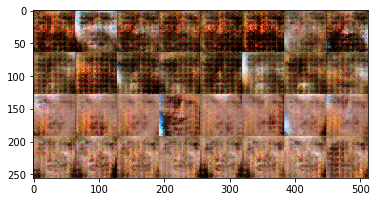

EPOCH 54 step 2800: D: loss = 1.0987692 G: loss=0.8615177 Time=13


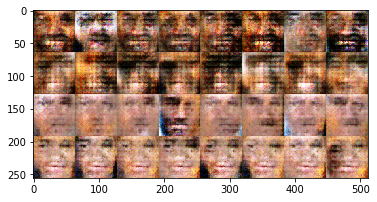

EPOCH 55 step 2850: D: loss = 1.4343538 G: loss=0.7695286 Time=13


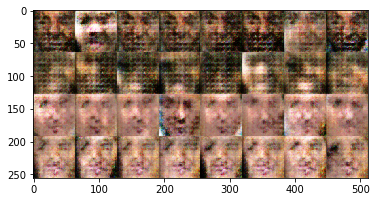

EPOCH 56 step 2900: D: loss = 1.1794627 G: loss=0.8345029 Time=13


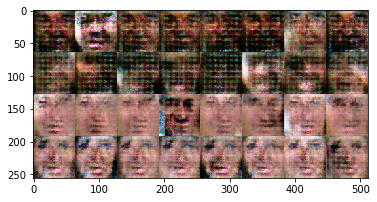

EPOCH 57 step 2950: D: loss = 1.3607191 G: loss=0.5580168 Time=12


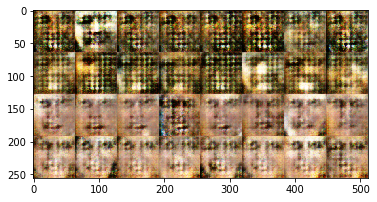

EPOCH 58 step 3000: D: loss = 1.3259186 G: loss=0.4989602 Time=12


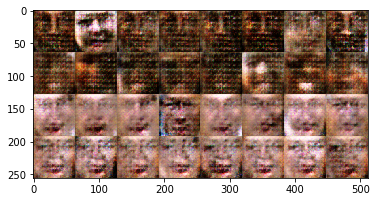

EPOCH 59 step 3050: D: loss = 1.1464722 G: loss=0.8874506 Time=12


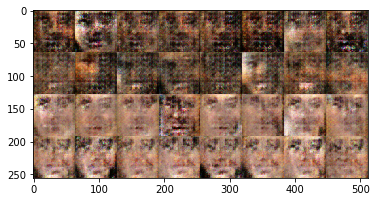

EPOCH 60 step 3100: D: loss = 1.3650837 G: loss=1.1044469 Time=12


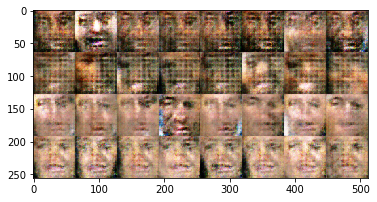

EPOCH 61 step 3150: D: loss = 1.2732966 G: loss=0.8093898 Time=11


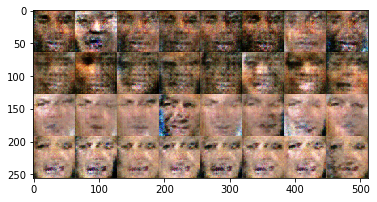

EPOCH 62 step 3200: D: loss = 1.3009362 G: loss=0.7206027 Time=11


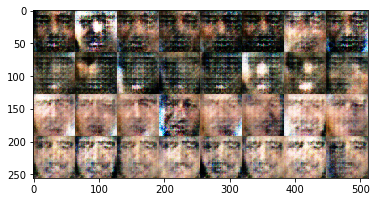

EPOCH 63 step 3250: D: loss = 1.2707319 G: loss=0.6233292 Time=11


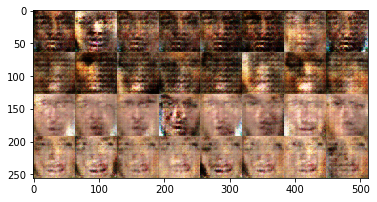

EPOCH 64 step 3300: D: loss = 1.2442474 G: loss=0.8997672 Time=10


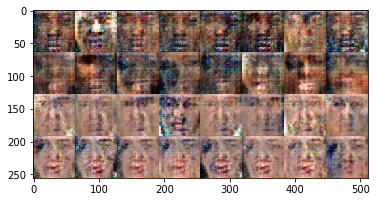

EPOCH 65 step 3350: D: loss = 1.1160427 G: loss=0.8893686 Time=10


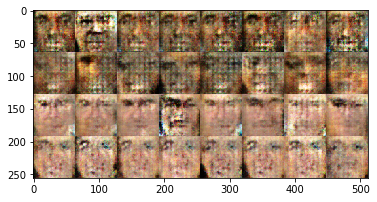

EPOCH 66 step 3400: D: loss = 1.3712645 G: loss=0.8079793 Time=10


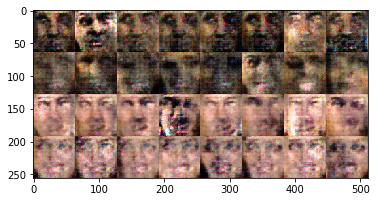

EPOCH 67 step 3450: D: loss = 1.1475651 G: loss=0.9268244 Time=10


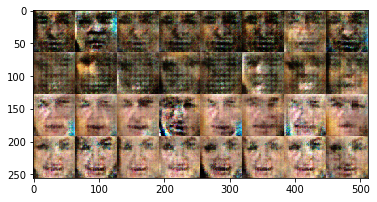

EPOCH 68 step 3500: D: loss = 1.3022597 G: loss=0.7607487 Time=9


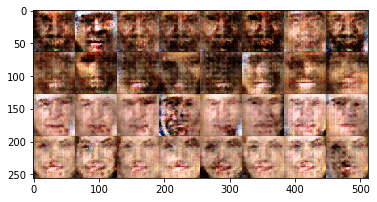

EPOCH 69 step 3550: D: loss = 1.2356603 G: loss=0.8359225 Time=9


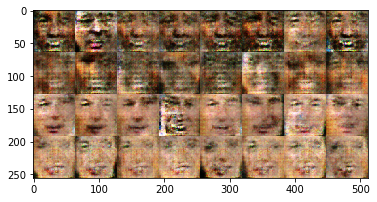

EPOCH 70 step 3600: D: loss = 1.7751040 G: loss=1.0596546 Time=9


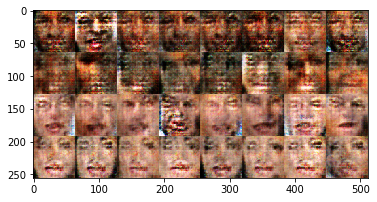

EPOCH 71 step 3650: D: loss = 1.3789028 G: loss=0.7510967 Time=8


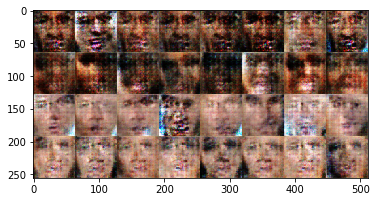

EPOCH 72 step 3700: D: loss = 1.8134478 G: loss=0.2710011 Time=8


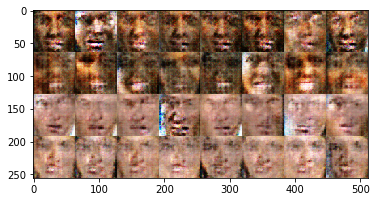

EPOCH 73 step 3750: D: loss = 1.2356164 G: loss=0.8352322 Time=8


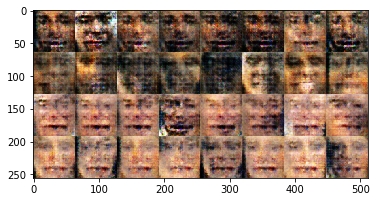

EPOCH 74 step 3800: D: loss = 1.0924680 G: loss=0.9781651 Time=7


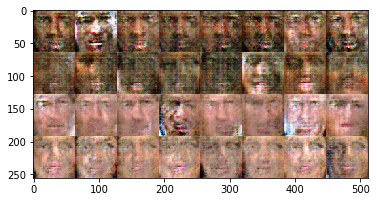

EPOCH 75 step 3850: D: loss = 1.2955523 G: loss=0.8208239 Time=7


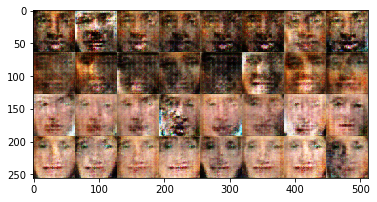

EPOCH 76 step 3900: D: loss = 1.4900165 G: loss=1.5004634 Time=7


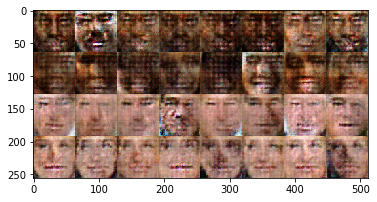

EPOCH 77 step 3950: D: loss = 1.1942056 G: loss=0.7870512 Time=6


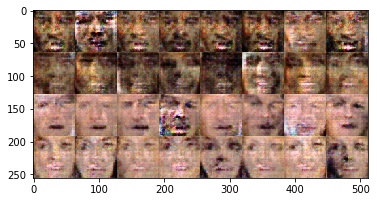

EPOCH 78 step 4000: D: loss = 1.2115003 G: loss=0.8300872 Time=6


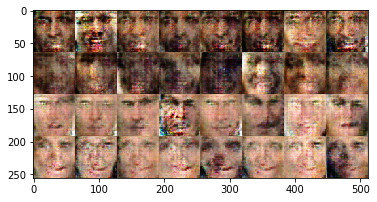

EPOCH 79 step 4050: D: loss = 1.1880236 G: loss=0.9884595 Time=6


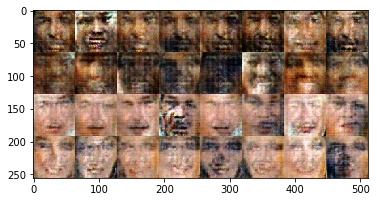

EPOCH 80 step 4100: D: loss = 1.2196902 G: loss=0.7431123 Time=6


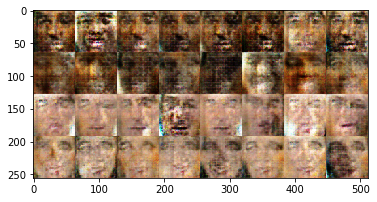

EPOCH 81 step 4150: D: loss = 1.2370639 G: loss=0.7318280 Time=5


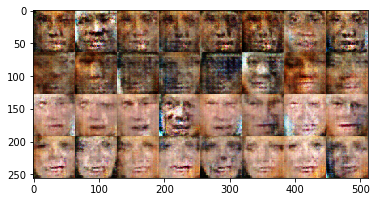

EPOCH 82 step 4200: D: loss = 1.4249028 G: loss=0.4147891 Time=5


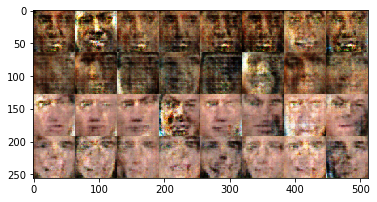

EPOCH 83 step 4250: D: loss = 1.2304025 G: loss=0.9553117 Time=5


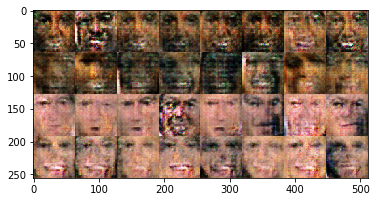

EPOCH 84 step 4300: D: loss = 1.4720113 G: loss=0.4583898 Time=4


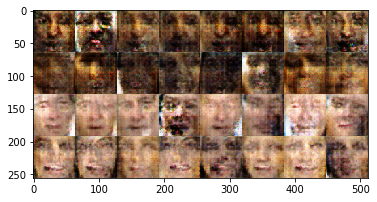

EPOCH 85 step 4350: D: loss = 1.3425081 G: loss=0.8368935 Time=4


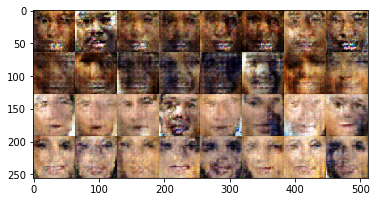

EPOCH 86 step 4400: D: loss = 1.4713124 G: loss=1.0667967 Time=4


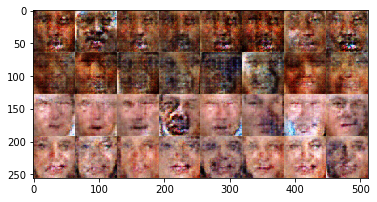

EPOCH 87 step 4450: D: loss = 1.2677202 G: loss=0.7943202 Time=3


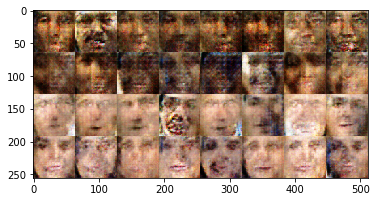

EPOCH 88 step 4500: D: loss = 1.4595108 G: loss=0.6430418 Time=3


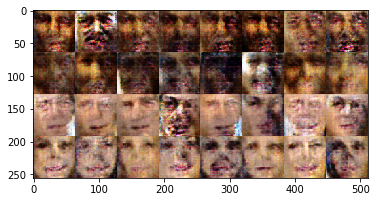

EPOCH 89 step 4550: D: loss = 1.3849124 G: loss=0.6497941 Time=3


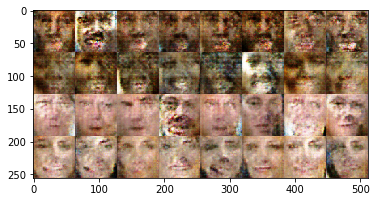

EPOCH 90 step 4600: D: loss = 1.3648386 G: loss=1.6549739 Time=3


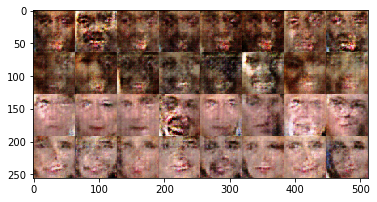

EPOCH 91 step 4650: D: loss = 1.1535034 G: loss=0.9252113 Time=2


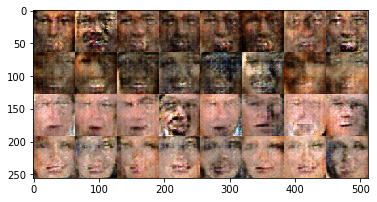

EPOCH 92 step 4700: D: loss = 1.3094373 G: loss=0.6589229 Time=2


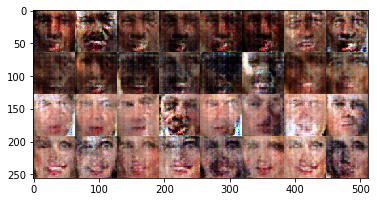

EPOCH 93 step 4750: D: loss = 1.4109221 G: loss=0.6484007 Time=2


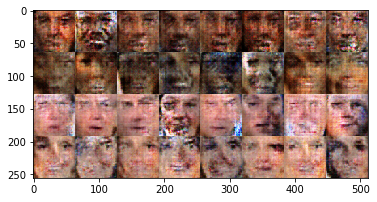

EPOCH 94 step 4800: D: loss = 1.3285093 G: loss=0.8053749 Time=1


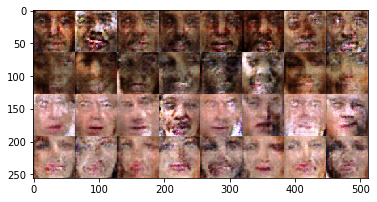

EPOCH 95 step 4850: D: loss = 1.3534129 G: loss=0.8043723 Time=1


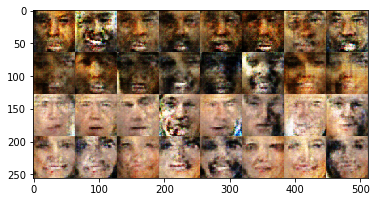

EPOCH 96 step 4900: D: loss = 1.3376808 G: loss=0.7817938 Time=1


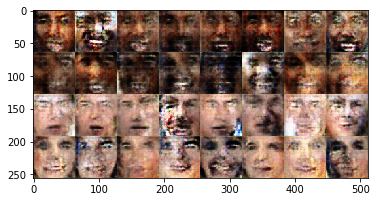

EPOCH 97 step 4950: D: loss = 1.2105536 G: loss=0.8585747 Time=1


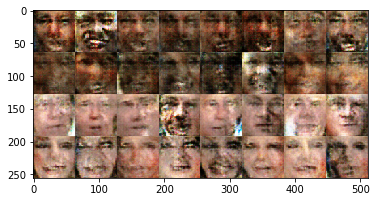

EPOCH 98 step 5000: D: loss = 1.1471411 G: loss=0.9068210 Time=0


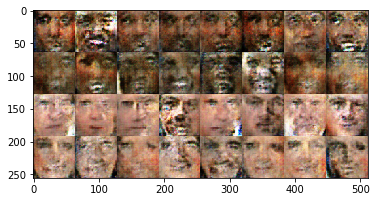

EPOCH 99 step 5050: D: loss = 1.3071311 G: loss=0.8432395 Time=0
EPOCH 99 step 5100: D: loss = 1.2178831 G: loss=0.8240979 Time=15


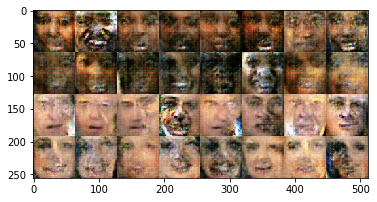

EPOCH 100 step 5150: D: loss = 1.2979121 G: loss=0.7926895 Time=15


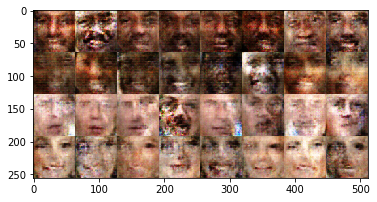

EPOCH 101 step 5200: D: loss = 1.3747841 G: loss=0.8605745 Time=14


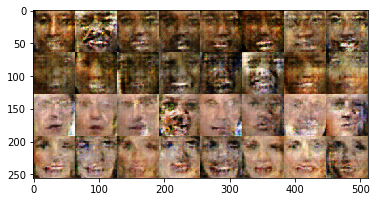

EPOCH 102 step 5250: D: loss = 1.2843792 G: loss=0.8580621 Time=14


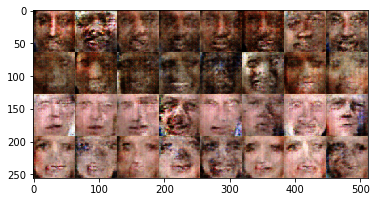

EPOCH 103 step 5300: D: loss = 1.2129927 G: loss=0.8151724 Time=14


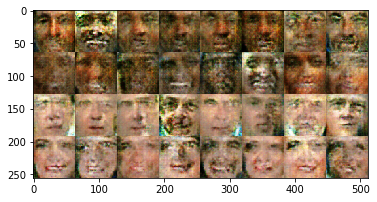

EPOCH 104 step 5350: D: loss = 1.3080115 G: loss=0.7409388 Time=13


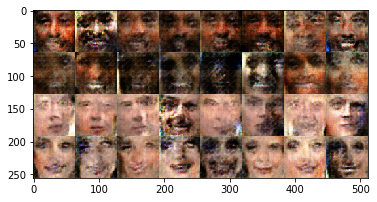

EPOCH 105 step 5400: D: loss = 1.2030387 G: loss=0.8536491 Time=13


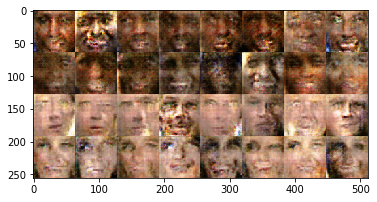

EPOCH 106 step 5450: D: loss = 1.1354244 G: loss=0.8505891 Time=13


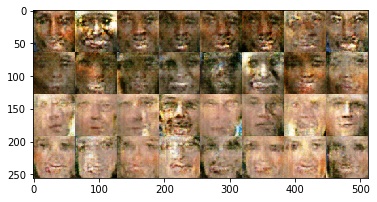

EPOCH 107 step 5500: D: loss = 1.9646406 G: loss=0.2225135 Time=12


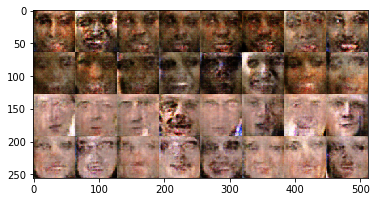

EPOCH 108 step 5550: D: loss = 1.3852911 G: loss=0.4773498 Time=12


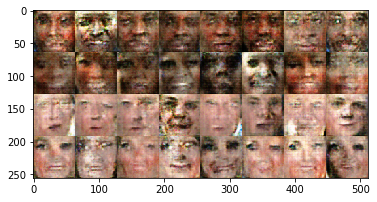

EPOCH 109 step 5600: D: loss = 1.1206284 G: loss=0.9459441 Time=12


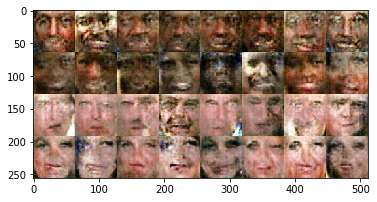

EPOCH 110 step 5650: D: loss = 1.2864313 G: loss=0.8639892 Time=12


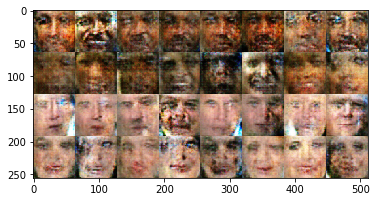

EPOCH 111 step 5700: D: loss = 1.2230439 G: loss=0.5913489 Time=11


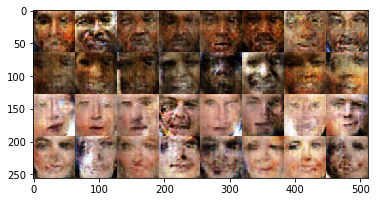

EPOCH 112 step 5750: D: loss = 1.2629511 G: loss=0.8019304 Time=11


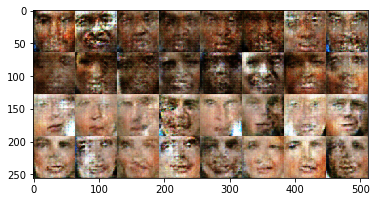

EPOCH 113 step 5800: D: loss = 1.3501531 G: loss=1.2706647 Time=11


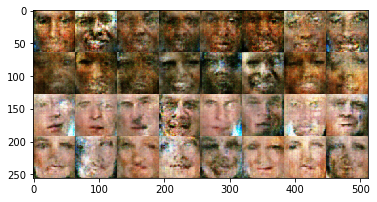

EPOCH 114 step 5850: D: loss = 1.3150535 G: loss=0.5352886 Time=10


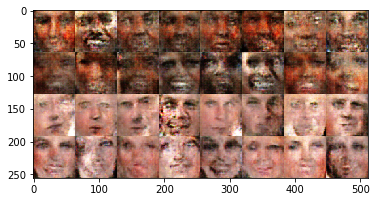

EPOCH 115 step 5900: D: loss = 1.1895845 G: loss=0.9705834 Time=10


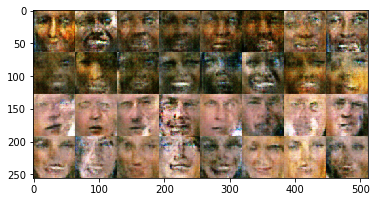

EPOCH 116 step 5950: D: loss = 1.2397004 G: loss=0.7664203 Time=10


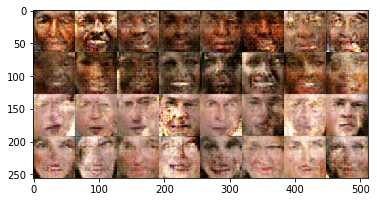

EPOCH 117 step 6000: D: loss = 1.1267240 G: loss=0.8841612 Time=10


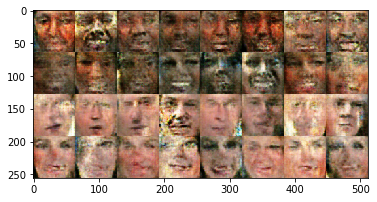

EPOCH 118 step 6050: D: loss = 1.1446786 G: loss=1.0330671 Time=9


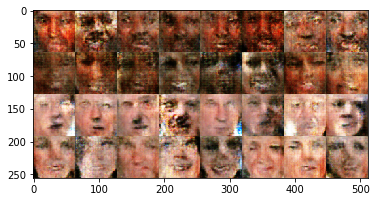

EPOCH 119 step 6100: D: loss = 1.2410637 G: loss=0.8306275 Time=9


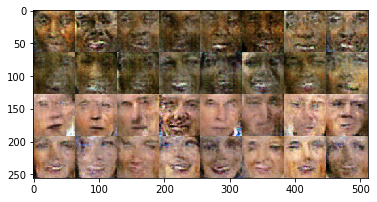

EPOCH 120 step 6150: D: loss = 1.2747453 G: loss=0.7774695 Time=9


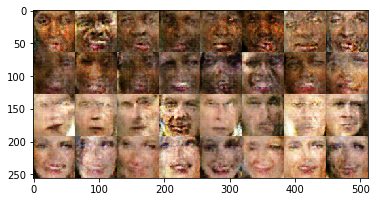

EPOCH 121 step 6200: D: loss = 1.1451392 G: loss=0.8916786 Time=8


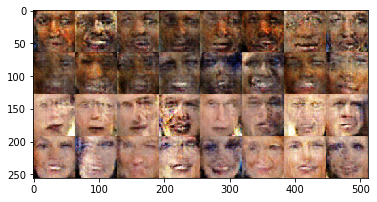

EPOCH 122 step 6250: D: loss = 1.4921064 G: loss=0.3824047 Time=8


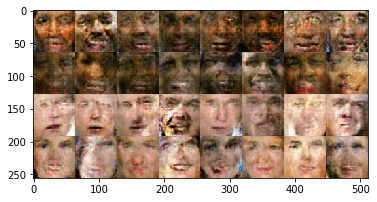

EPOCH 123 step 6300: D: loss = 1.2421424 G: loss=0.9541203 Time=8


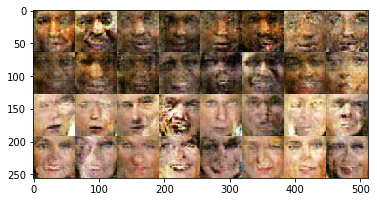

EPOCH 124 step 6350: D: loss = 1.2340810 G: loss=0.7900029 Time=7


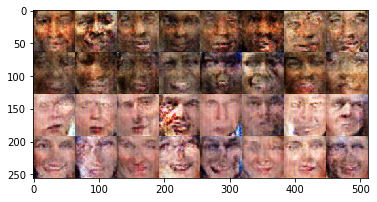

EPOCH 125 step 6400: D: loss = 1.2472117 G: loss=0.8287595 Time=7


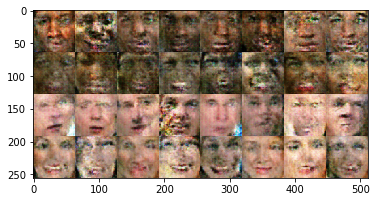

EPOCH 126 step 6450: D: loss = 1.1297131 G: loss=0.6865891 Time=7


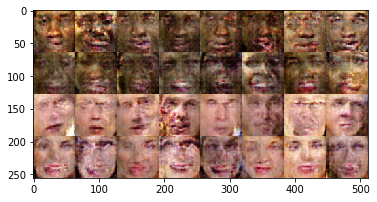

EPOCH 127 step 6500: D: loss = 1.1824212 G: loss=0.9485402 Time=6


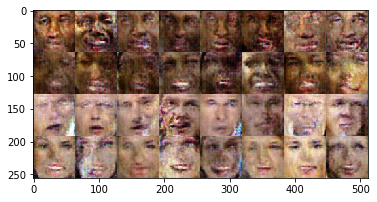

EPOCH 128 step 6550: D: loss = 1.3148555 G: loss=0.6960889 Time=6


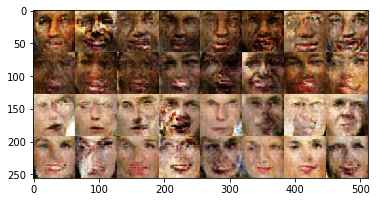

EPOCH 129 step 6600: D: loss = 1.0804236 G: loss=0.9762957 Time=6


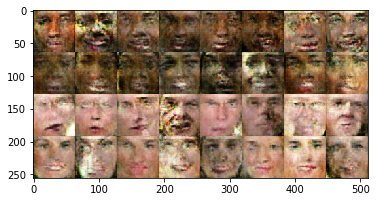

EPOCH 130 step 6650: D: loss = 1.3122363 G: loss=0.7758887 Time=6


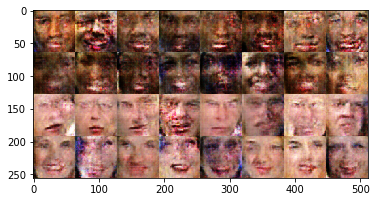

EPOCH 131 step 6700: D: loss = 1.3554631 G: loss=1.3374071 Time=5


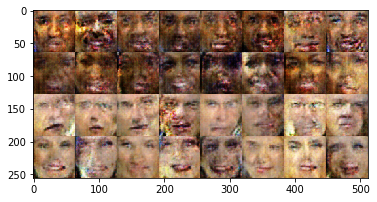

EPOCH 132 step 6750: D: loss = 2.1868033 G: loss=2.6194320 Time=5


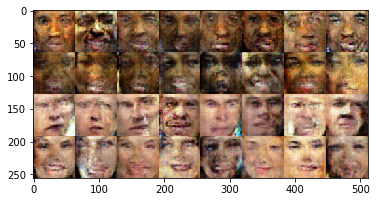

EPOCH 133 step 6800: D: loss = 1.2836201 G: loss=0.6736321 Time=5


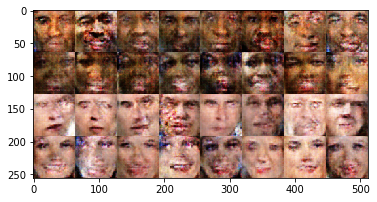

EPOCH 134 step 6850: D: loss = 1.1959240 G: loss=0.7432187 Time=4


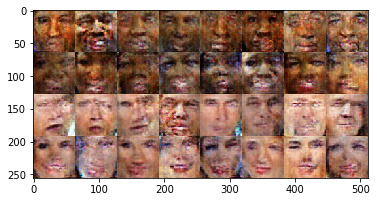

EPOCH 135 step 6900: D: loss = 1.3907303 G: loss=0.8233671 Time=4


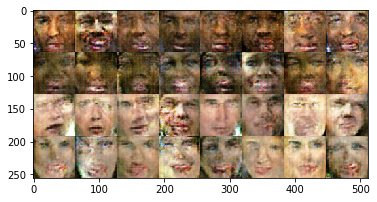

EPOCH 136 step 6950: D: loss = 1.7661090 G: loss=0.3212336 Time=4


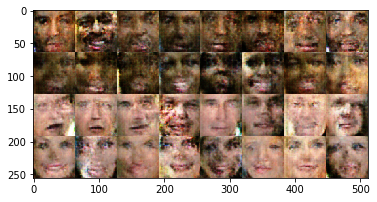

EPOCH 137 step 7000: D: loss = 1.2702765 G: loss=0.7246511 Time=4


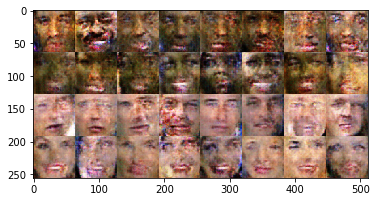

EPOCH 138 step 7050: D: loss = 1.9069891 G: loss=2.1763656 Time=3


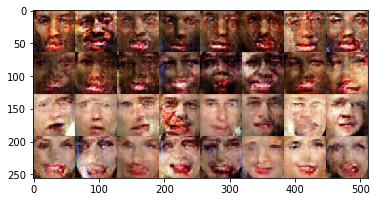

EPOCH 139 step 7100: D: loss = 1.2428138 G: loss=0.8487287 Time=3


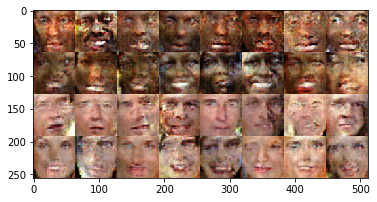

EPOCH 140 step 7150: D: loss = 1.1982523 G: loss=0.8370590 Time=3


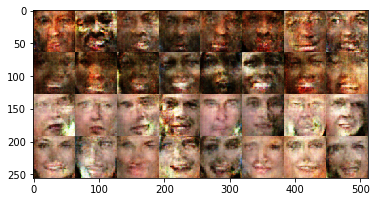

EPOCH 141 step 7200: D: loss = 1.1915648 G: loss=0.8914714 Time=2


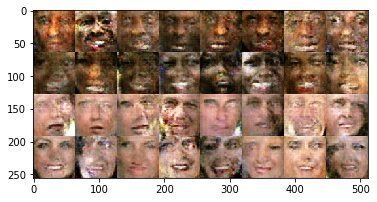

EPOCH 142 step 7250: D: loss = 1.2404174 G: loss=0.9217973 Time=2


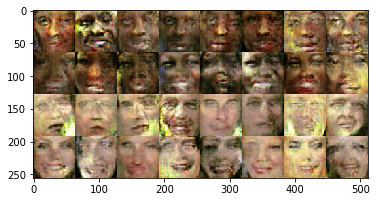

EPOCH 143 step 7300: D: loss = 1.2743785 G: loss=0.7944996 Time=2


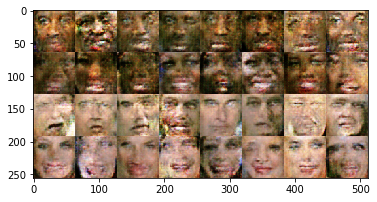

EPOCH 144 step 7350: D: loss = 1.2135029 G: loss=0.8538463 Time=1


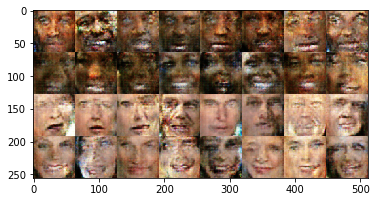

EPOCH 145 step 7400: D: loss = 1.0783606 G: loss=0.8428805 Time=1


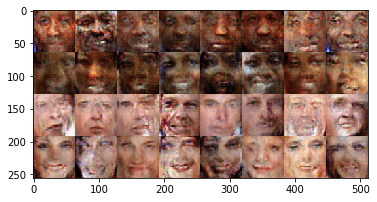

EPOCH 146 step 7450: D: loss = 1.3001735 G: loss=0.8441640 Time=1


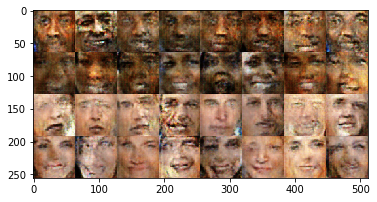

EPOCH 147 step 7500: D: loss = 1.1343145 G: loss=0.8697588 Time=1


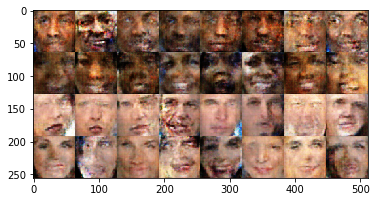

EPOCH 148 step 7550: D: loss = 1.2370462 G: loss=0.6321189 Time=0


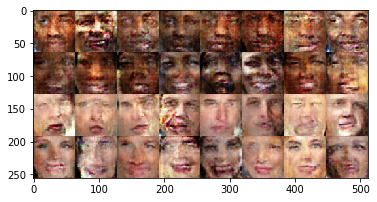

EPOCH 149 step 7600: D: loss = 1.3951377 G: loss=0.5915934 Time=0
EPOCH 149 step 7650: D: loss = 1.1907593 G: loss=0.8575889 Time=15


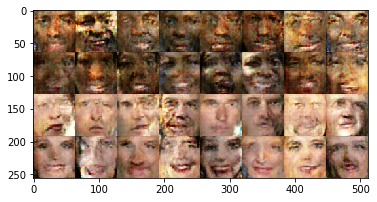

EPOCH 150 step 7700: D: loss = 1.2165526 G: loss=0.7557583 Time=15


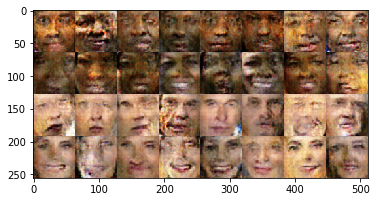

EPOCH 151 step 7750: D: loss = 1.1562289 G: loss=1.2352139 Time=14


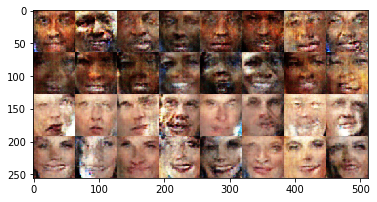

EPOCH 152 step 7800: D: loss = 1.2841833 G: loss=0.7342065 Time=14


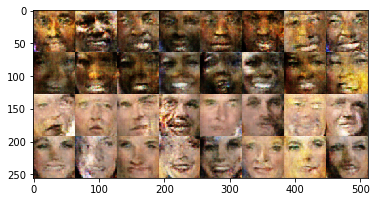

EPOCH 153 step 7850: D: loss = 1.0964286 G: loss=1.0229950 Time=13


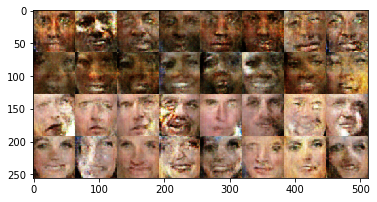

EPOCH 154 step 7900: D: loss = 1.1385952 G: loss=0.7549165 Time=13


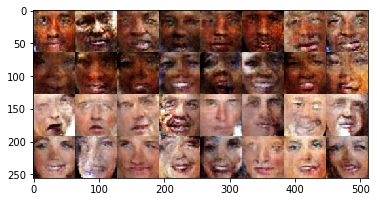

EPOCH 155 step 7950: D: loss = 1.0928612 G: loss=0.9024792 Time=13


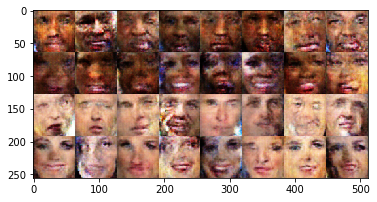

EPOCH 156 step 8000: D: loss = 1.2729199 G: loss=0.8616942 Time=13


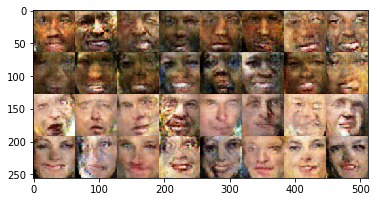

EPOCH 157 step 8050: D: loss = 1.2557557 G: loss=0.7928981 Time=12


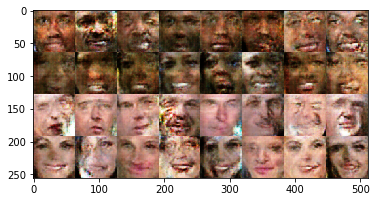

EPOCH 158 step 8100: D: loss = 1.2249625 G: loss=0.7400050 Time=12


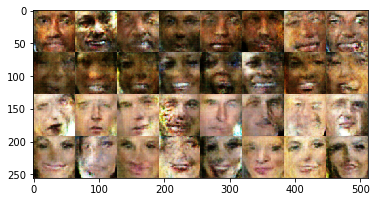

EPOCH 159 step 8150: D: loss = 1.2829676 G: loss=0.8784327 Time=12


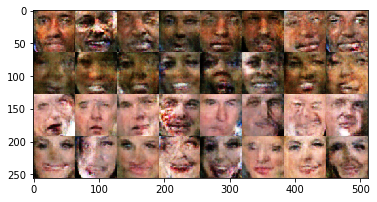

EPOCH 160 step 8200: D: loss = 1.2698784 G: loss=0.5887144 Time=12


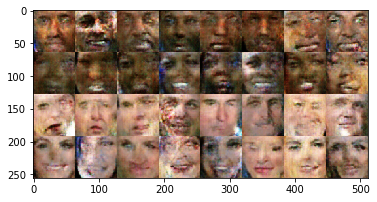

EPOCH 161 step 8250: D: loss = 1.2633042 G: loss=0.7786111 Time=11


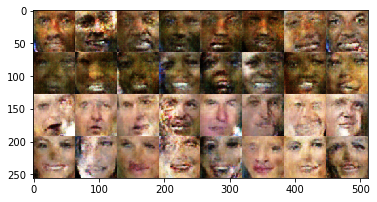

EPOCH 162 step 8300: D: loss = 1.1408297 G: loss=0.8654183 Time=11


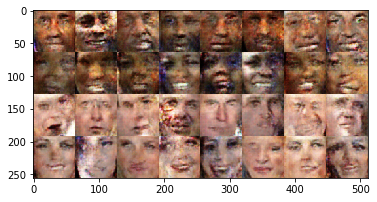

EPOCH 163 step 8350: D: loss = 1.2199304 G: loss=0.9522132 Time=11


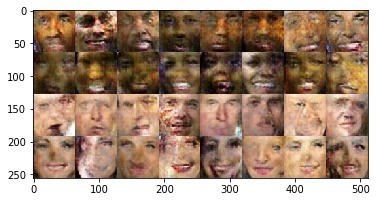

EPOCH 164 step 8400: D: loss = 1.3073313 G: loss=0.9776800 Time=10


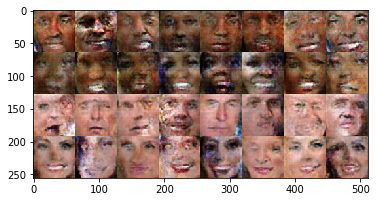

EPOCH 165 step 8450: D: loss = 1.5114658 G: loss=1.7621037 Time=10


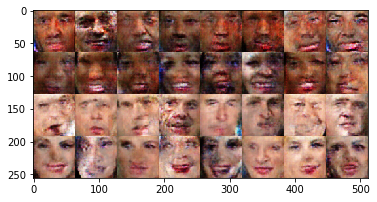

EPOCH 166 step 8500: D: loss = 1.1899219 G: loss=1.1008896 Time=10


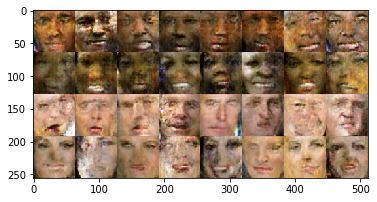

EPOCH 167 step 8550: D: loss = 1.2540708 G: loss=0.7518035 Time=9


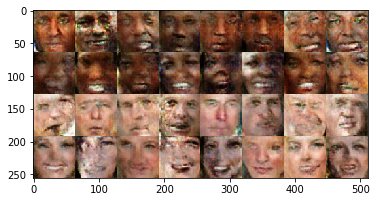

EPOCH 168 step 8600: D: loss = 1.2233796 G: loss=0.7846529 Time=9


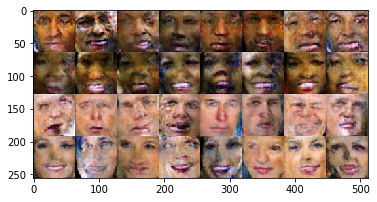

EPOCH 169 step 8650: D: loss = 1.1689470 G: loss=0.9380624 Time=9


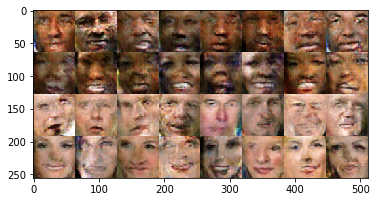

EPOCH 170 step 8700: D: loss = 1.1744201 G: loss=0.8899016 Time=9


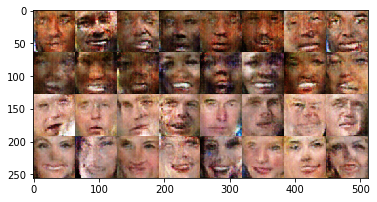

EPOCH 171 step 8750: D: loss = 1.1361250 G: loss=0.7700350 Time=8


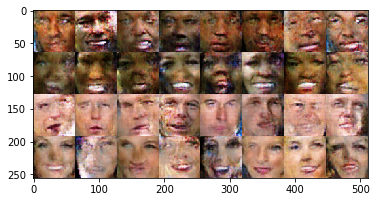

EPOCH 172 step 8800: D: loss = 1.2481599 G: loss=0.8117939 Time=8


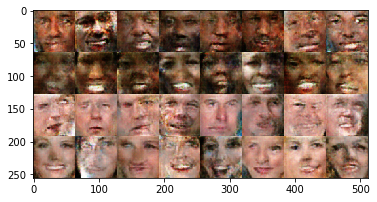

EPOCH 173 step 8850: D: loss = 1.1813439 G: loss=0.9777830 Time=8


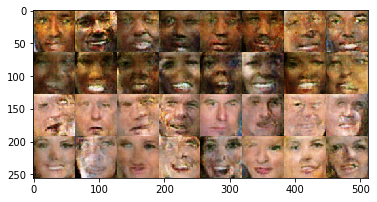

EPOCH 174 step 8900: D: loss = 1.1468220 G: loss=0.8370695 Time=7


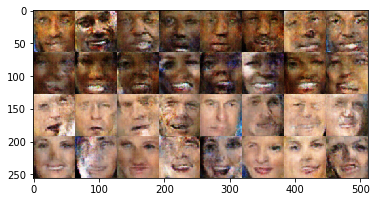

EPOCH 175 step 8950: D: loss = 1.1236432 G: loss=0.8740396 Time=7


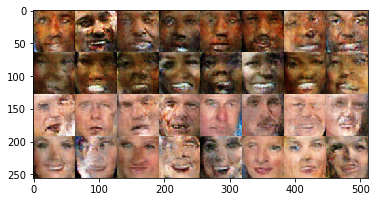

EPOCH 176 step 9000: D: loss = 1.0491917 G: loss=1.0203580 Time=7


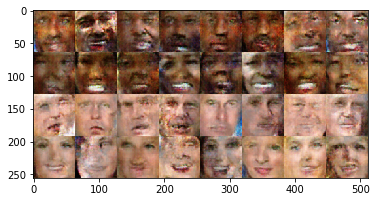

EPOCH 177 step 9050: D: loss = 1.2145991 G: loss=0.8758448 Time=7


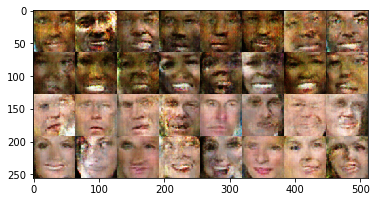

EPOCH 178 step 9100: D: loss = 1.0901284 G: loss=0.9340293 Time=6


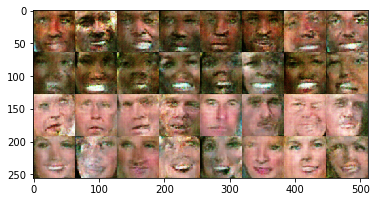

EPOCH 179 step 9150: D: loss = 1.2350130 G: loss=0.7802549 Time=6


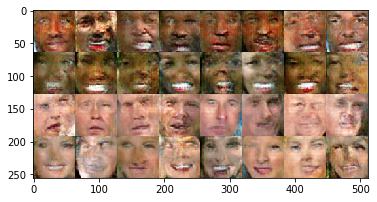

EPOCH 180 step 9200: D: loss = 1.2294855 G: loss=0.8683508 Time=6


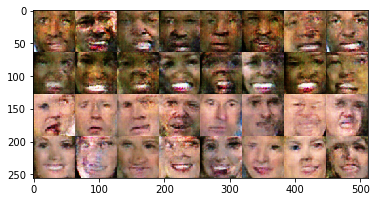

EPOCH 181 step 9250: D: loss = 1.1182857 G: loss=0.8909920 Time=5


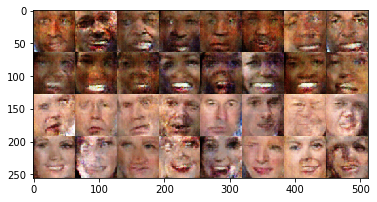

EPOCH 182 step 9300: D: loss = 1.0753257 G: loss=0.9100896 Time=5


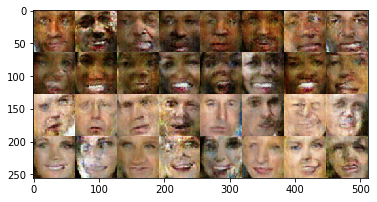

EPOCH 183 step 9350: D: loss = 1.2042644 G: loss=1.3606300 Time=5


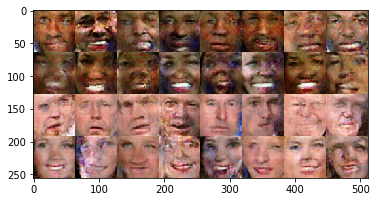

EPOCH 184 step 9400: D: loss = 1.1195668 G: loss=0.7987450 Time=4


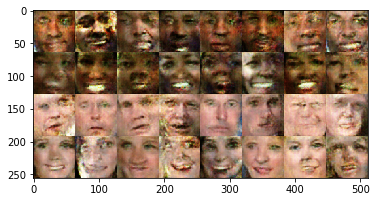

EPOCH 185 step 9450: D: loss = 1.1694576 G: loss=0.8917248 Time=4


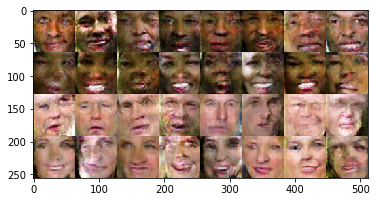

EPOCH 186 step 9500: D: loss = 1.2079352 G: loss=0.8920948 Time=4


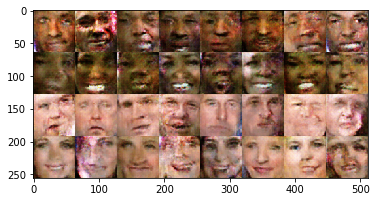

EPOCH 187 step 9550: D: loss = 1.2099693 G: loss=0.8222284 Time=3


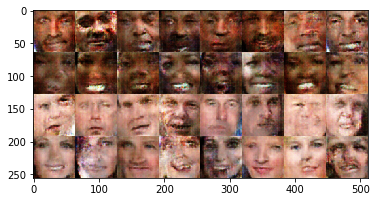

EPOCH 188 step 9600: D: loss = 1.5613610 G: loss=1.9162483 Time=3


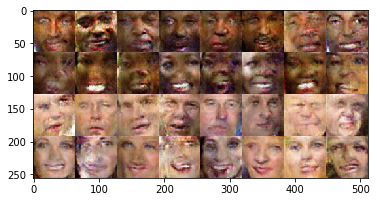

EPOCH 189 step 9650: D: loss = 1.3157325 G: loss=0.5730263 Time=3


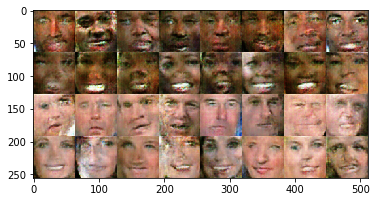

EPOCH 190 step 9700: D: loss = 1.1501817 G: loss=0.9402280 Time=3


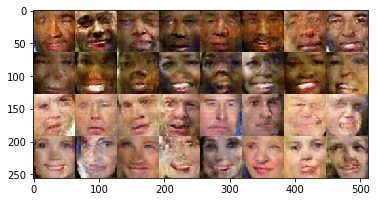

EPOCH 191 step 9750: D: loss = 1.0678310 G: loss=0.9691949 Time=2


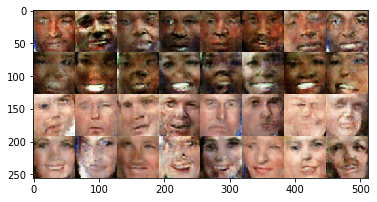

EPOCH 192 step 9800: D: loss = 1.2168220 G: loss=0.8620393 Time=2


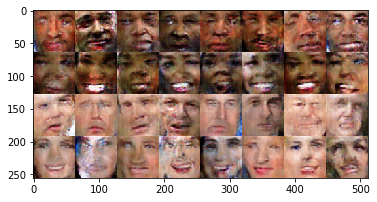

EPOCH 193 step 9850: D: loss = 1.1156063 G: loss=0.7765535 Time=2


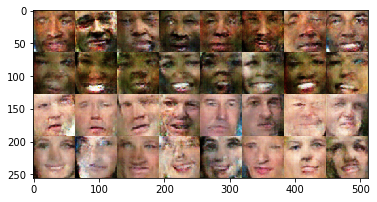

EPOCH 194 step 9900: D: loss = 1.2466776 G: loss=0.6945311 Time=1


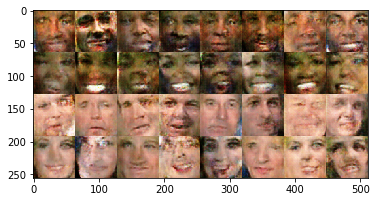

EPOCH 195 step 9950: D: loss = 1.1281099 G: loss=0.8683251 Time=1


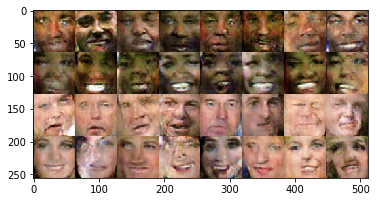

EPOCH 196 step 10000: D: loss = 1.2342095 G: loss=0.7767894 Time=1


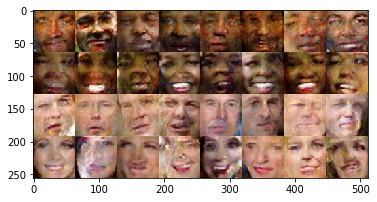

EPOCH 197 step 10050: D: loss = 1.0968381 G: loss=1.0778328 Time=0


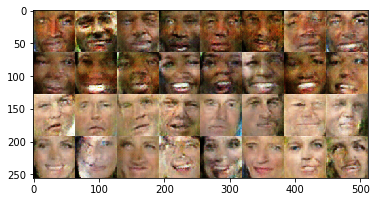

EPOCH 198 step 10100: D: loss = 1.1898440 G: loss=0.8495496 Time=0


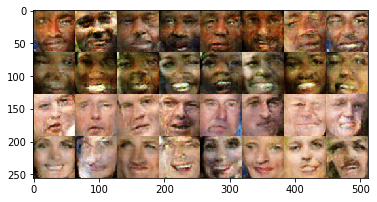

EPOCH 199 step 10150: D: loss = 1.1797643 G: loss=0.8928113 Time=0
EPOCH 199 step 10200: D: loss = 1.1829726 G: loss=0.7937438 Time=15


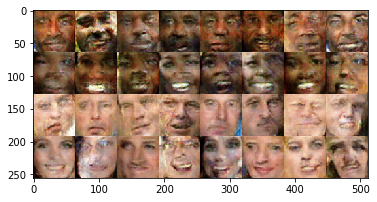

EPOCH 200 step 10250: D: loss = 1.3678912 G: loss=0.9351438 Time=15


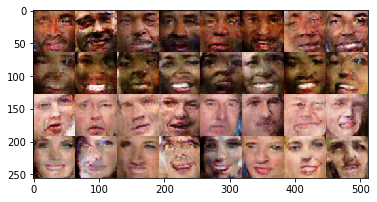

time takes : 3112.224280357361


In [8]:
#### TODO ####
import time

tf.reset_default_graph()

sample_z = np.random.uniform(-1 , 1 , size = [batch_size , sample_size])

y = tf.placeholder(tf.float32, [None , y_dim])

images = tf.placeholder(tf.float32, [batch_size, output_size, output_size, channel])

z = tf.placeholder(tf.float32, [None , sample_size])

fake_images = gern_net(batch_size, z , y ,sample_size, y_dim,output_size,False)

##the loss of gerenate network
D_pro , D_logits = dis_net(images, y , batch_size, False)
G_pro, G_logits = dis_net(fake_images , y , batch_size, True)

fake_images_2 = gern_net(batch_size,z,y,sample_size,y_dim,output_size,True)
# DEFINE LOSS FUNCTION #

D_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.zeros_like(G_pro),logits=G_logits)) + tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.ones_like(D_pro),logits=D_logits))
G_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.ones_like(G_pro),logits=G_logits))

t_vars = tf.trainable_variables()

d_var = [var for var in t_vars if 'dis' in var.name]
g_var = [var for var in t_vars if 'gen' in var.name]

opti_D = tf.train.AdamOptimizer(learning_rate=learning_rate , beta1=0.5).minimize(D_loss , var_list=d_var)
opti_G = tf.train.AdamOptimizer(learning_rate=learning_rate , beta1=0.5).minimize(G_loss , var_list=g_var)

init = tf.global_variables_initializer()
config = tf.ConfigProto()
config.gpu_options.allow_growth = True

with tf.Session(config=config) as sess:

    sess.run(init)
    e = 0
    step = 0
    total_time = time.time()
    while e <= EPOCH:
        batch_num = 0
        start = time.time()
        while batch_num < len(im) / batch_size - 1:
            step = step + 1

            realbatch_array , real_labels = getNext_batch(im , label , batch_num, batch_size)
            
            #Get the z
            batch_z = np.random.uniform(-1 , 1 , size=[batch_size , sample_size])

            _ = sess.run(opti_D, feed_dict={images:realbatch_array, z:batch_z , y:real_labels})
            _ = sess.run(opti_G, feed_dict={z: batch_z , y:real_labels})

            batch_num += 1

            if step % loss_step == 0:

                d_get_loss = sess.run(D_loss , feed_dict = {images:realbatch_array , z:batch_z , y:real_labels})
                g_get_loss = sess.run(G_loss , feed_dict = {z: batch_z , y:real_labels})
                print("EPOCH %d step %d: D: loss = %.7f G: loss=%.7f Time=%d" % (e , step , d_get_loss , g_get_loss, time.time()-start))

            if np.mod(step , display_step) == 1:
                sample_face_input = sample_label_face(batch_size)
                sample_face_input[:4] = [2,-2,2]
                sample_images = sess.run(fake_images_2 , feed_dict={z:sample_z , y:sample_label_face(batch_size)})
                sample_images = sample_images[:32,:,:,:]
                #print(sample_images.shape)
                image_name = './{}/train_{:02d}_{:04d}.png'.format(sample_dir , e , step)
                save_images(sample_images , [4,8] , image_name)

        img = mpimg.imread(image_name)
        imgplot = plt.imshow(img)
        plt.show()

        e = e + 1
        batch_num = 0
    print("time takes : {}".format(time.time()-total_time))
